<a href="https://colab.research.google.com/github/AlvaroUriel/idal_ia3/blob/main/pendulumExample.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1
!apt-get install -y xvfb python-opengl ffmpeg > /dev/null 2>&1

In [2]:
import gym
from gym import logger as gymlogger
from gym.wrappers import Monitor
gymlogger.set_level(40) #error only
import tensorflow as tf
import numpy as np
import random
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import math
import glob
import io
import base64
from IPython.display import HTML

from IPython import display as ipythondisplay

In [3]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1400, 900))
display.start()

In [4]:
def show_video():
  mp4list = glob.glob('video/*.mp4')
  if len(mp4list) > 0:
    mp4 = mp4list[0]
    video = io.open(mp4, 'r+b').read()
    encoded = base64.b64encode(video)
    ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
  else: 
    print("Could not find video")
    

def wrap_env(env):
  env = Monitor(env, './video', force=True)
  return env

In [8]:
import gym
import random
from keras import Sequential
from collections import deque
from keras.layers import Dense
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import math
import numpy as np
env = wrap_env(gym.make('Pendulum-v0'))
env.seed(0)
np.random.seed(0)

In [9]:
class DQN:

    """ Implementation of deep q learning algorithm """

    def __init__(self, action_space, state_space):

        self.action_space = action_space
        self.state_space = state_space
        self.epsilon = 1
        self.gamma = .95
        self.batch_size = 64
        self.epsilon_min = .01
        self.epsilon_decay = .995
        self.learning_rate = 0.001
        self.memory = deque(maxlen=10000)
        self.model = self.build_model()

    def build_model(self):

        model = Sequential()
        model.add(Dense(24, input_shape=(self.state_space,), activation='relu'))
        model.add(Dense(24, activation='relu'))
        model.add(Dense(self.action_space, activation='linear'))
        model.compile(loss='mse', optimizer=Adam(lr=self.learning_rate))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])

    def replay(self):

        if len(self.memory) < self.batch_size:
            return

        minibatch = random.sample(self.memory, self.batch_size)
        states = np.array([i[0] for i in minibatch])
        actions = np.array([i[1] for i in minibatch])
        rewards = np.array([i[2] for i in minibatch])
        next_states = np.array([i[3] for i in minibatch])
        dones = np.array([i[4] for i in minibatch])

        states = np.squeeze(states)
        next_states = np.squeeze(next_states)

        targets = rewards + self.gamma*(np.amax(self.model.predict_on_batch(next_states), axis=1))*(1-dones)
        targets_full = self.model.predict_on_batch(states)

        ind = np.array([i for i in range(self.batch_size)])
        targets_full[[ind], [actions]] = targets
        self.model.fit(states, targets_full, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

In [10]:

def train_dqn(episode):
    global env
    loss = []
    #agent = DQN(env.action_space.n, env.observation_space.shape[0])
    agent = DQN(5, env.observation_space.shape[0])
    for e in range(episode):
        temp=[]
        state = env.reset()
        state = np.reshape(state, (1, 3))
        score = 0
        maxp = -1.2
        max_steps = 1000
        for i in range(max_steps):
            env.render()
            action = agent.act(state)
            torque = [-2+action]
            next_state, reward, done, _ = env.step(torque)
            next_state = np.reshape(next_state, (1, 3))
            if (next_state[0,0]>0.95):
                score=score+1
            reward= 25*np.exp(-1*(next_state[0,0]-1)*(next_state[0,0]-1)/0.001)-100*np.abs(10*0.5 - (10*0.5*next_state[0,0] + 0.5*0.3333*next_state[0,2] * next_state[0,2])) + 100*np.abs(10*0.5 - (10*0.5*state[0,0] + 0.5*0.3333*state[0,2] * state[0,2]))
            maxp = max(maxp, next_state[0,0])
            temp.append(next_state[0,0])
            agent.remember(state, action, reward, next_state, done)
            state = next_state
            agent.replay()
            if done:
                print("episode: {}/{}, score: {}".format(e, episode, score))
                print(maxp)
                plt.plot([i for i in range(0, 200, 1)], temp[::1])
                plt.show()
                env.close()
                show_video()
                env = wrap_env(gym.make('Pendulum-v0'))
                env.seed(episode)
                break
        loss.append(score)
    return loss

In [11]:

def random_policy(episode, step):

    for i_episode in range(episode):
        env.reset()
        for t in range(step):
            action = env.action_space.sample()
            state, reward, done, info = env.step(action)
            if done:
                print("Episode finished after {} timesteps".format(t+1))
                break
            print("Starting next episode")

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


episode: 0/200, score: 6
0.9999251340392148


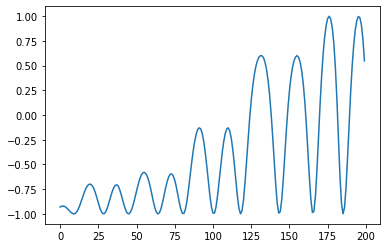

episode: 1/200, score: 25
0.9999205687879201


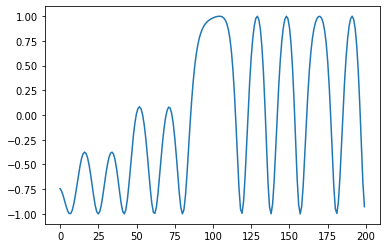

episode: 2/200, score: 13
0.9998242117019617


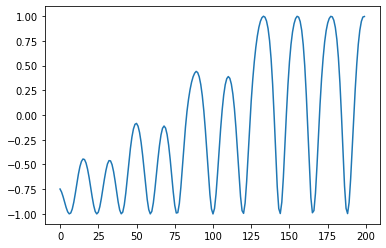

episode: 3/200, score: 0
0.3464762354499467


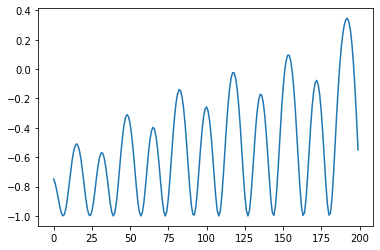

episode: 4/200, score: 6
0.9996006784334561


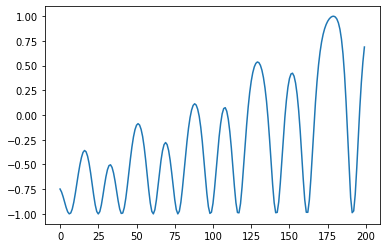

episode: 5/200, score: 13
0.9993755510189529


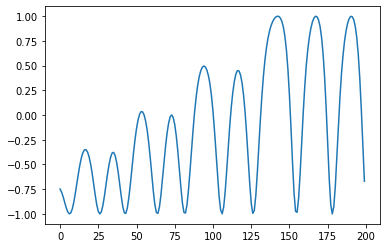

episode: 6/200, score: 11
0.9984969188145254


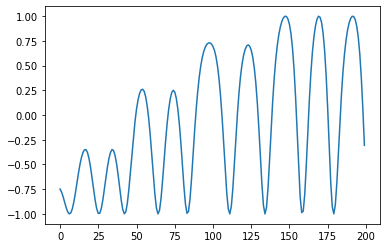

episode: 7/200, score: 4
0.9990243642228619


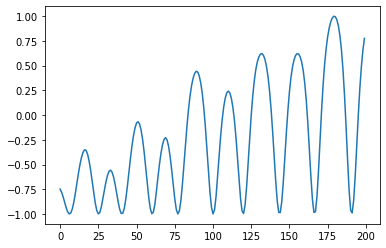

episode: 8/200, score: 0
0.926769939643597


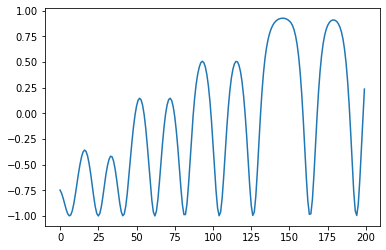

episode: 9/200, score: 13
0.999406827690096


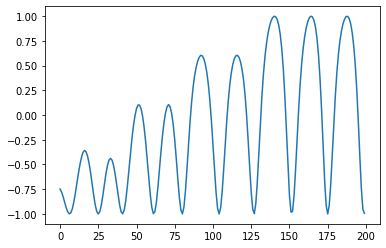

episode: 10/200, score: 12
0.999355529684954


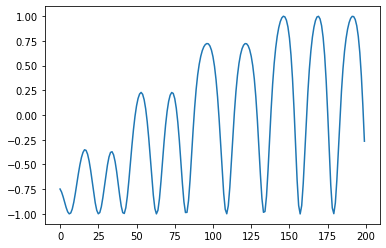

episode: 11/200, score: 13
0.9999623725188818


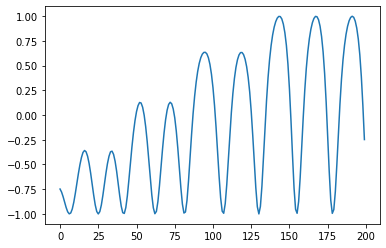

episode: 12/200, score: 12
0.9998051165471


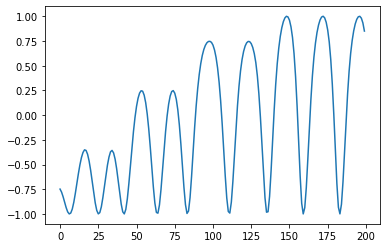

episode: 13/200, score: 12
0.9985887275479427


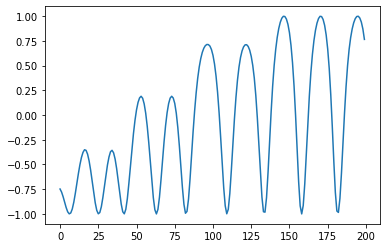

episode: 14/200, score: 14
0.9999248930588748


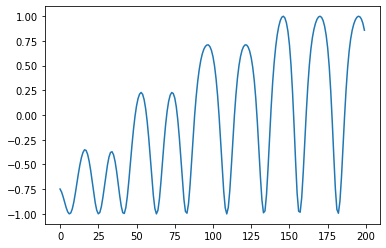

episode: 15/200, score: 13
0.9999092590060621


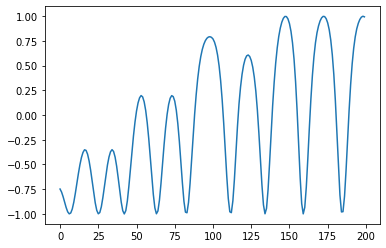

episode: 16/200, score: 14
0.999991662187385


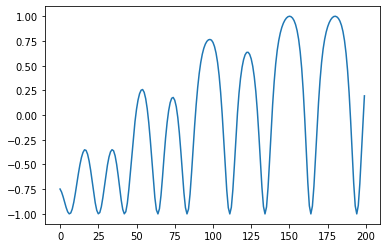

episode: 17/200, score: 15
0.9999211250311447


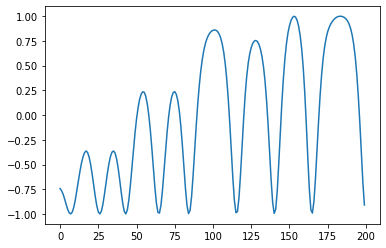

episode: 18/200, score: 18
0.9997894148347334


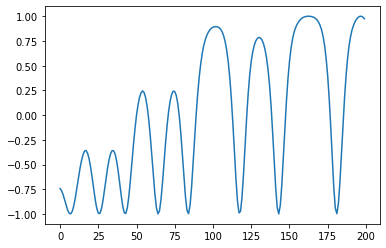

episode: 19/200, score: 39
0.9999450797047231


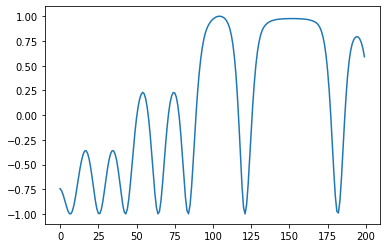

episode: 20/200, score: 24
0.9999978902031521


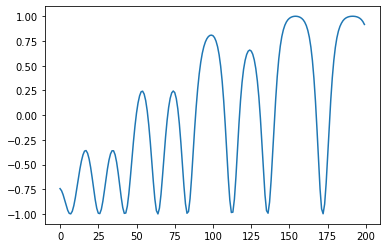

episode: 21/200, score: 6
0.9992293151615906


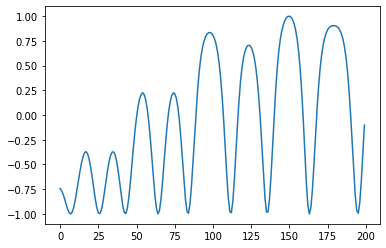

episode: 22/200, score: 0
0.8449753423517017


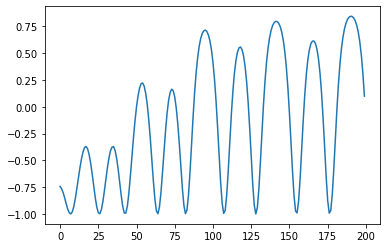

episode: 23/200, score: 17
0.9998920825051596


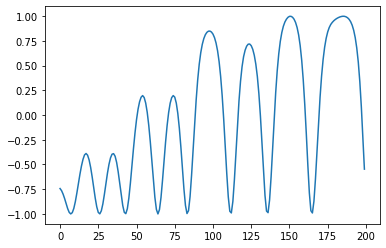

episode: 24/200, score: 21
0.9998978439306011


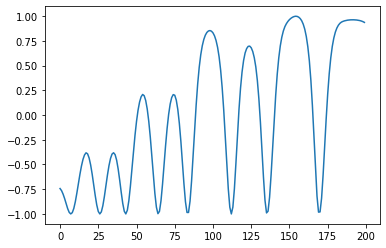

episode: 25/200, score: 5
0.9998743459816858


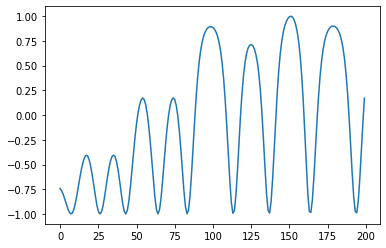

episode: 26/200, score: 39
0.9999442736357816


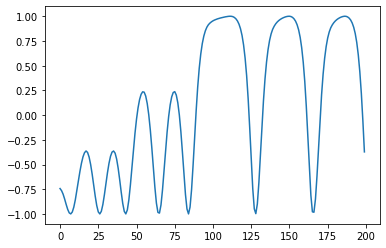

episode: 27/200, score: 16
0.9999708555991124


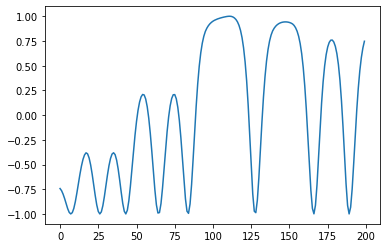

episode: 28/200, score: 19
0.9999665092842064


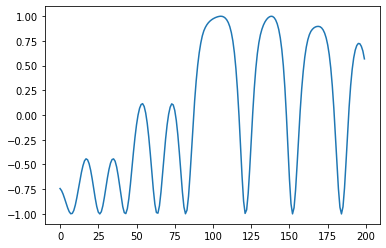

episode: 29/200, score: 23
0.9999504172362276


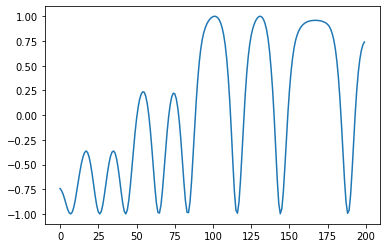

episode: 30/200, score: 10
0.9997959457017571


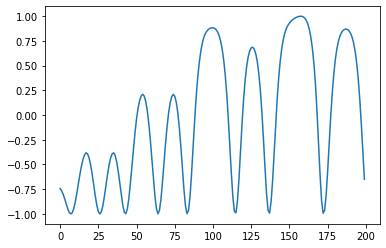

episode: 31/200, score: 21
0.9999359949600252


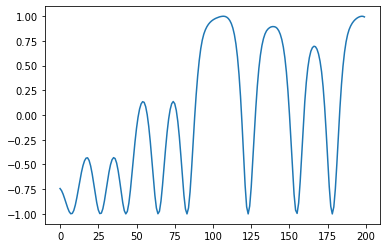

episode: 32/200, score: 15
0.9999991857687903


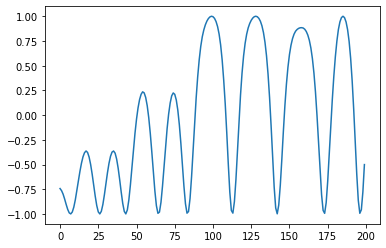

episode: 33/200, score: 4
0.9999997891430465


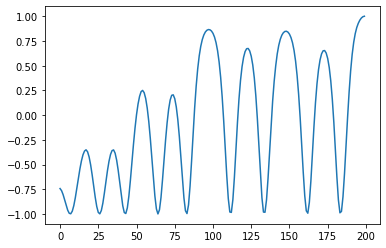

episode: 34/200, score: 11
0.9999982865752927


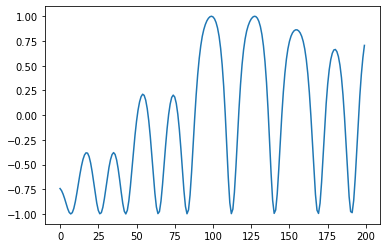

episode: 35/200, score: 18
0.9999813975834068


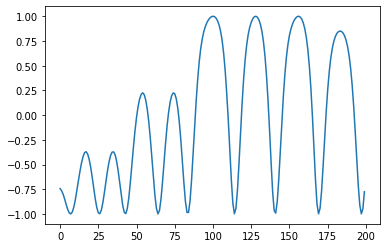

episode: 36/200, score: 12
0.9999505357892735


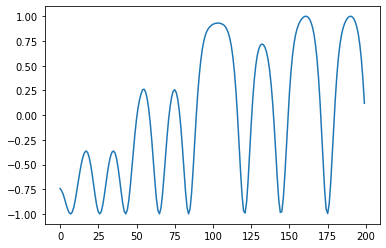

episode: 37/200, score: 26
0.9999980541928221


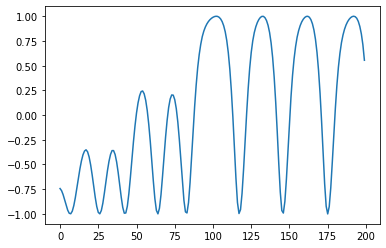

episode: 38/200, score: 30
0.9999890129173006


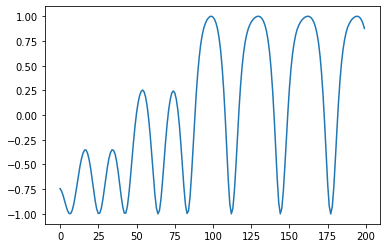

episode: 39/200, score: 34
0.9999525320186903


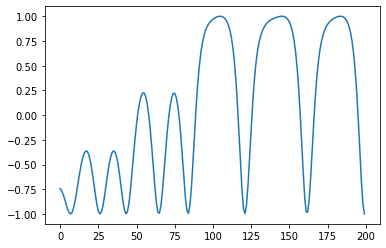

episode: 40/200, score: 28
0.999867092779341


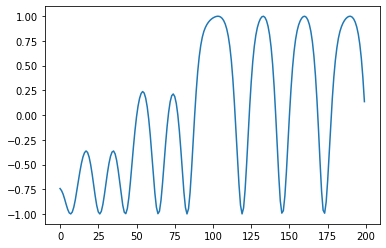

episode: 41/200, score: 26
0.9999980791998148


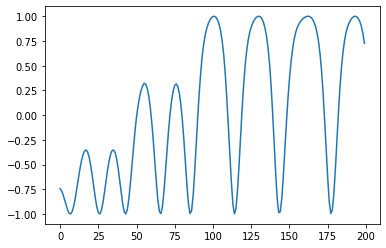

episode: 42/200, score: 27
0.9999946777545925


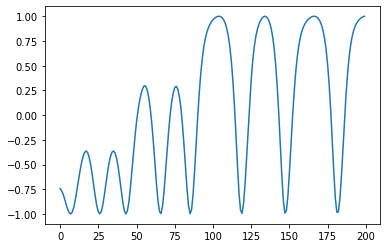

episode: 43/200, score: 29
0.9999885303410773


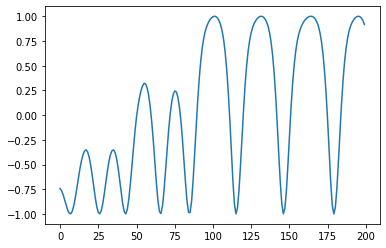

episode: 44/200, score: 27
0.9999836897123435


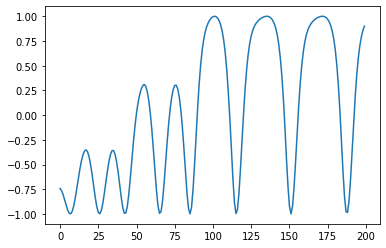

episode: 45/200, score: 28
0.999970573310336


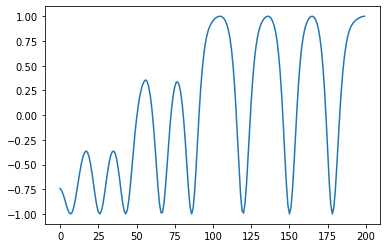

episode: 46/200, score: 26
0.9999977621424866


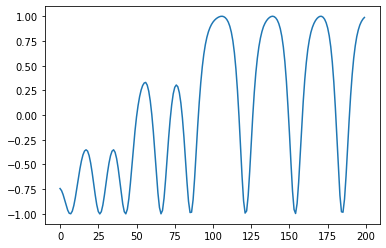

episode: 47/200, score: 29
0.9999277956330558


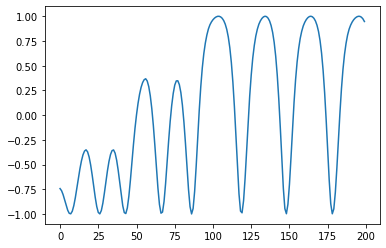

episode: 48/200, score: 27
0.9999995508574407


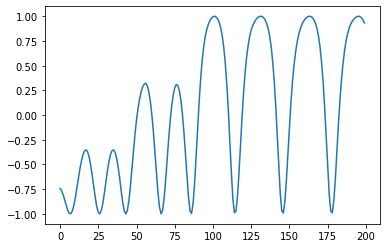

episode: 49/200, score: 28
0.9997336438211992


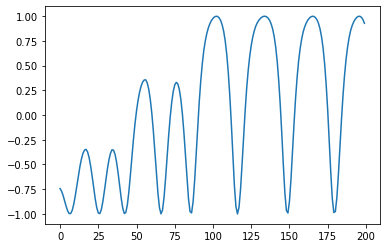

episode: 50/200, score: 25
0.9999950884786364


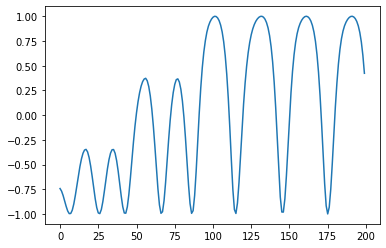

episode: 51/200, score: 25
0.9998777841537435


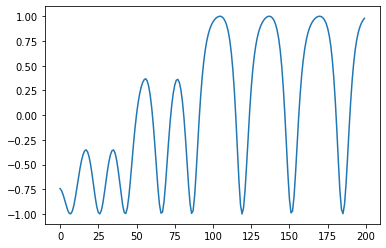

episode: 52/200, score: 25
0.999464407842982


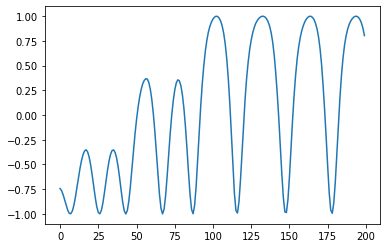

episode: 53/200, score: 27
0.9999750274189032


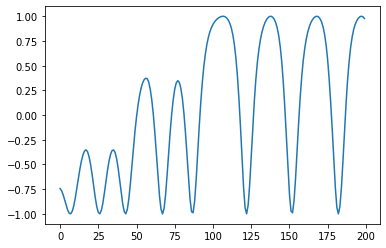

episode: 54/200, score: 27
0.9997988788652261


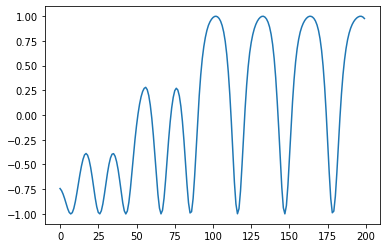

episode: 55/200, score: 28
0.9999838172076703


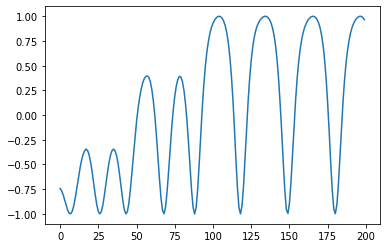

episode: 56/200, score: 26
0.9997438791694951


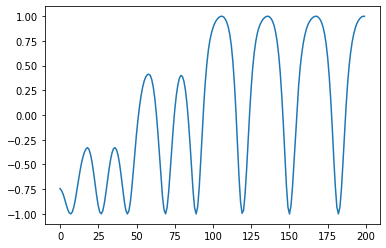

episode: 57/200, score: 26
0.9999751003732921


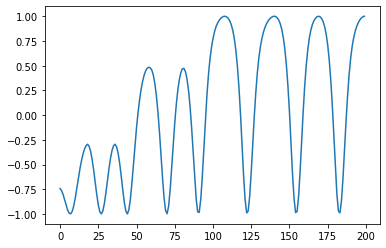

episode: 58/200, score: 21
0.9999997538324522


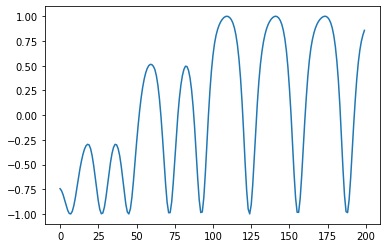

episode: 59/200, score: 23
0.9998564399226465


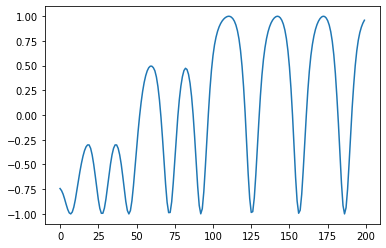

episode: 60/200, score: 24
0.9999184016515361


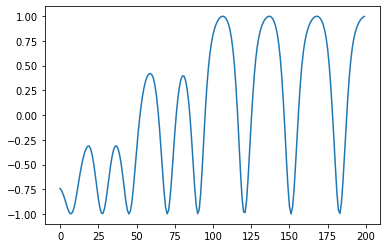

episode: 61/200, score: 24
0.9999902722655603


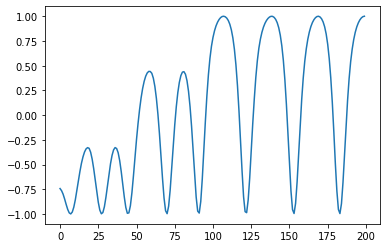

episode: 62/200, score: 23
0.9999659100874811


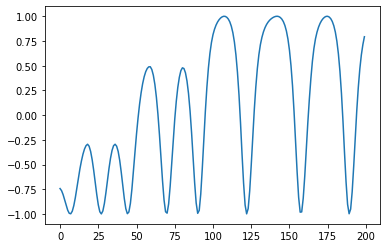

episode: 63/200, score: 22
0.999395936401809


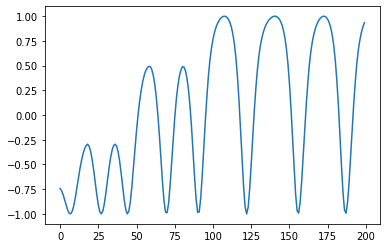

episode: 64/200, score: 23
0.9999999804075576


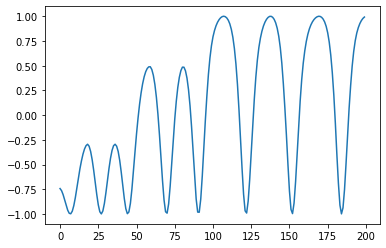

episode: 65/200, score: 22
0.9998895844088252


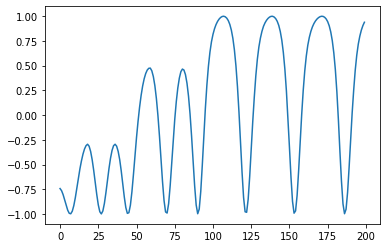

episode: 66/200, score: 23
0.9999565087148188


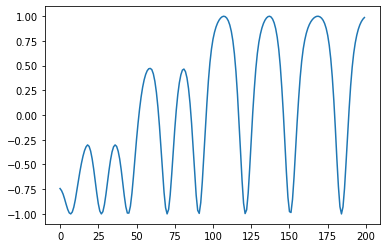

episode: 67/200, score: 25
0.9999918789232023


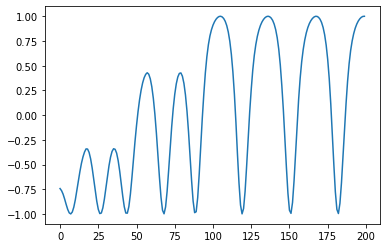

episode: 68/200, score: 22
0.9999945086947247


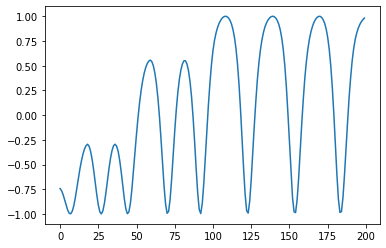

episode: 69/200, score: 23
0.9999737882520986


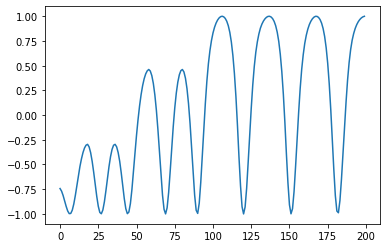

episode: 70/200, score: 23
0.999974559109274


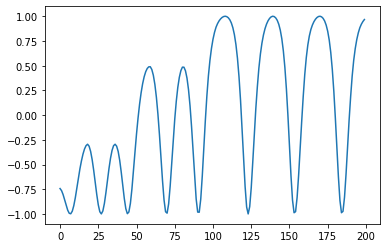

episode: 71/200, score: 23
0.9998694146144135


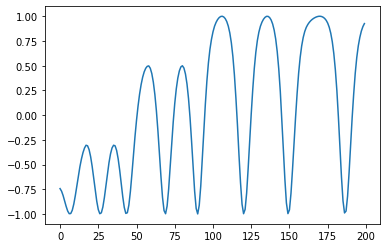

episode: 72/200, score: 22
0.9999912727076784


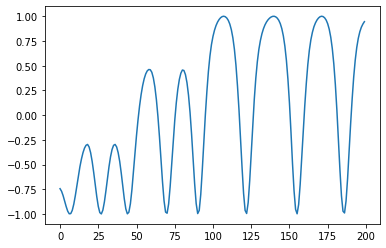

episode: 73/200, score: 22
0.9999850278786471


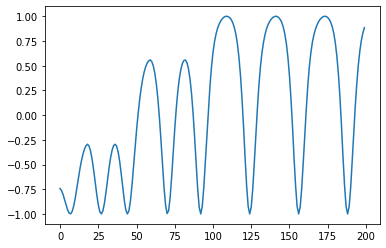

episode: 74/200, score: 22
0.9999857364325438


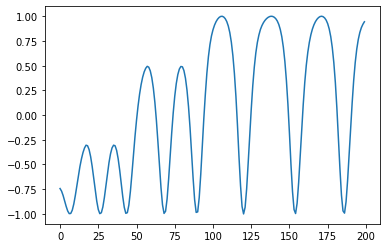

episode: 75/200, score: 25
0.9999786286941855


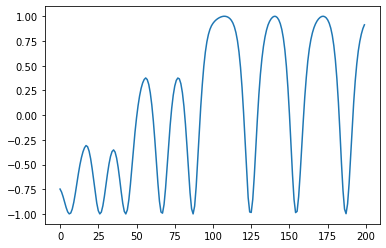

episode: 76/200, score: 29
0.9997935848276887


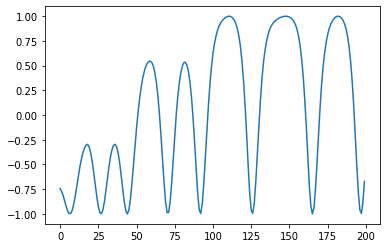

episode: 77/200, score: 26
0.999946526182406


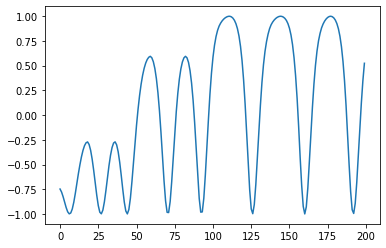

episode: 78/200, score: 26
0.9999776014500871


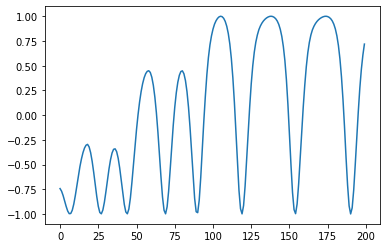

episode: 79/200, score: 25
0.999942825881848


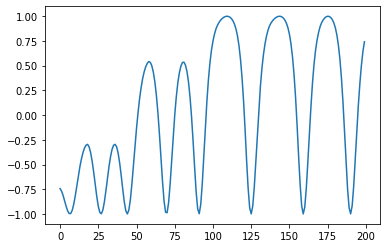

episode: 80/200, score: 24
0.9999915562630218


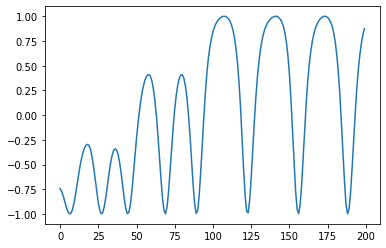

episode: 81/200, score: 24
0.9999998708873229


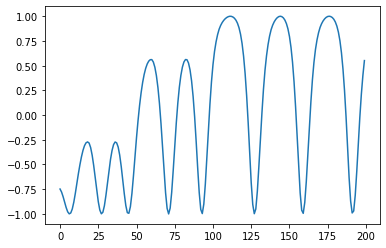

episode: 82/200, score: 27
0.9999463356082169


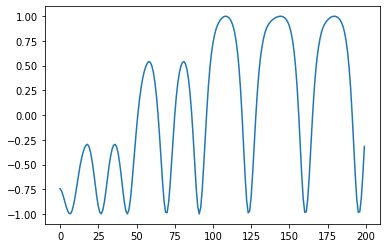

episode: 83/200, score: 26
0.9999999873117569


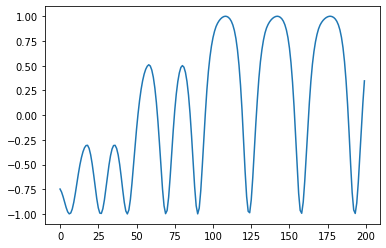

episode: 84/200, score: 28
0.9999589578748285


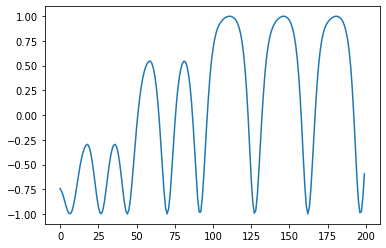

episode: 85/200, score: 26
0.999991675368409


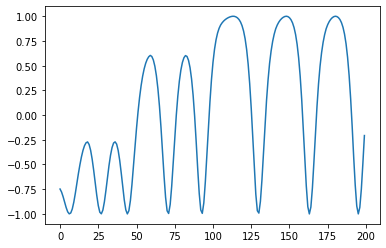

episode: 86/200, score: 31
0.9999986141075611


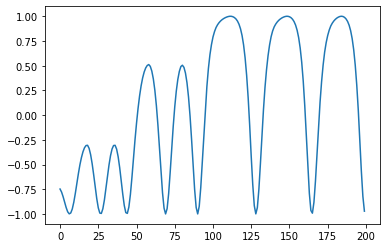

episode: 87/200, score: 30
0.999761544590566


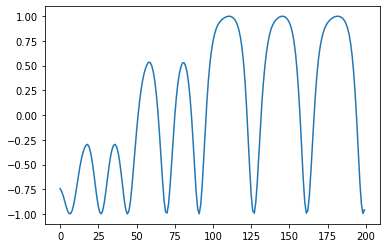

episode: 88/200, score: 28
0.9999879879043545


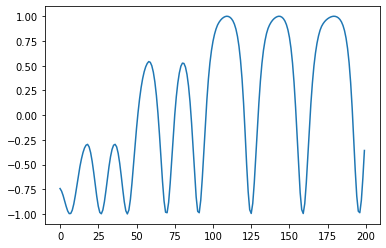

episode: 89/200, score: 29
0.999977538388084


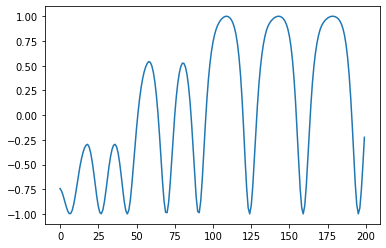

episode: 90/200, score: 26
0.999976171140809


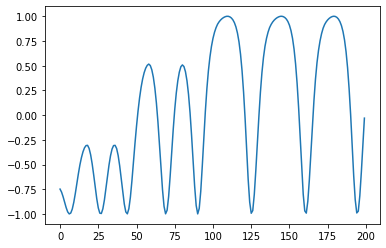

episode: 91/200, score: 26
0.9996109537455268


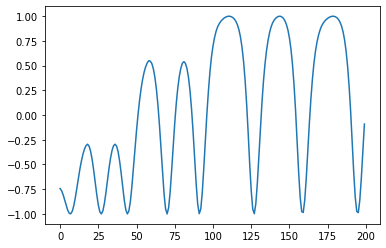

episode: 92/200, score: 30
0.9999804065521707


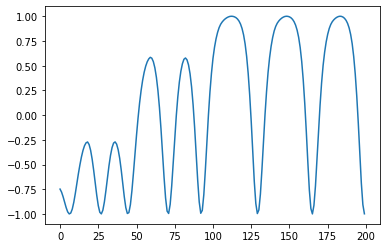

episode: 93/200, score: 24
0.9999994842523047


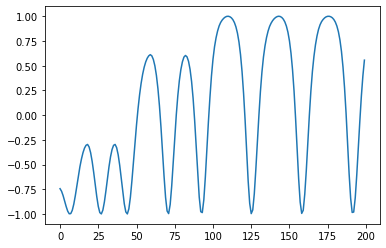

episode: 94/200, score: 29
0.9999999991438923


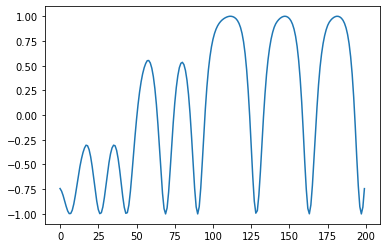

episode: 95/200, score: 29
0.9999926942009179


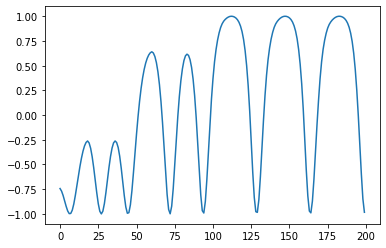

episode: 96/200, score: 28
0.9999940885541024


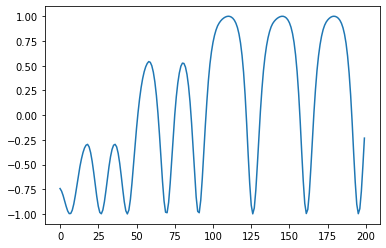

episode: 97/200, score: 28
0.9999999355070769


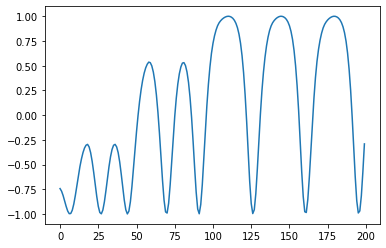

episode: 98/200, score: 26
0.9999183849306429


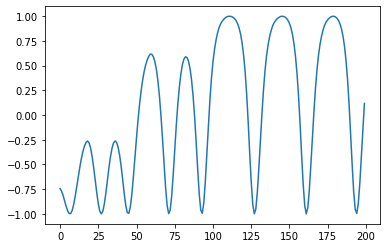

episode: 99/200, score: 28
0.9998712662356959


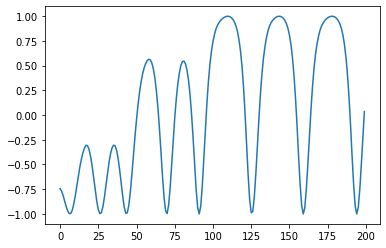

episode: 100/200, score: 28
0.9999748235512107


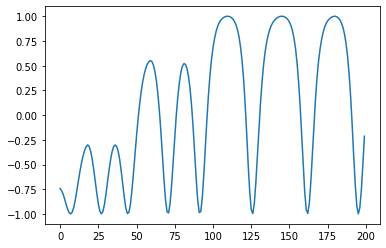

episode: 101/200, score: 27
0.9999872812951353


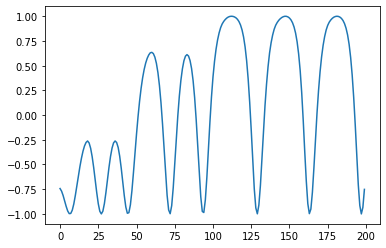

episode: 102/200, score: 29
0.9999817980684095


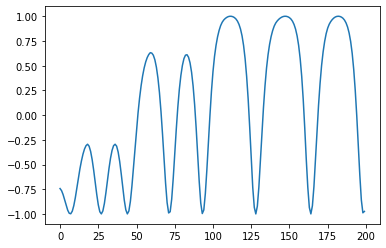

episode: 103/200, score: 32
0.9999971911563154


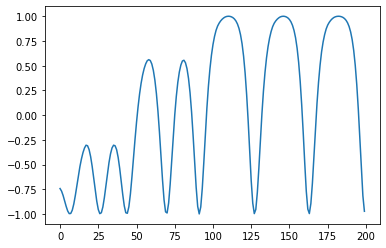

episode: 104/200, score: 32
0.9999874324336419


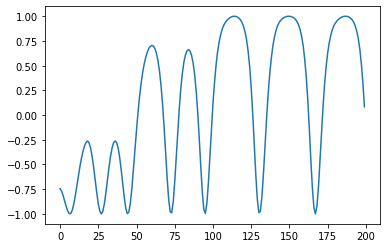

episode: 105/200, score: 31
0.9999963821165319


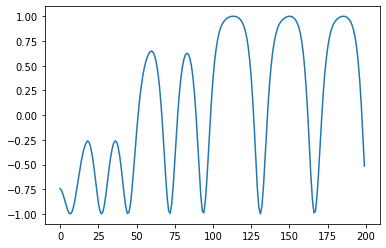

episode: 106/200, score: 32
0.9999657385216946


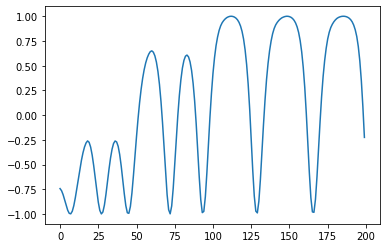

episode: 107/200, score: 36
0.9999601334058164


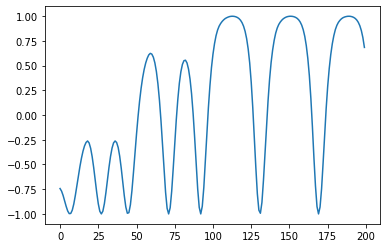

episode: 108/200, score: 32
0.9999670176816816


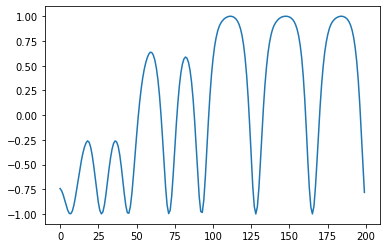

episode: 109/200, score: 32
0.999997310683324


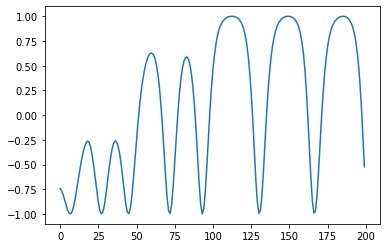

episode: 110/200, score: 34
0.9999985301343953


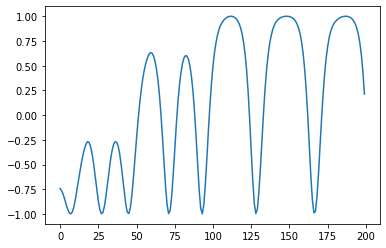

episode: 111/200, score: 33
0.9999917511728191


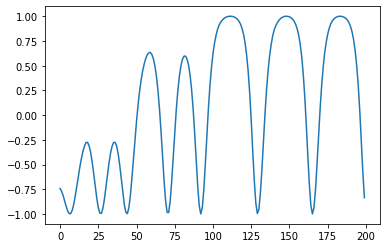

episode: 112/200, score: 33
0.9999974756521688


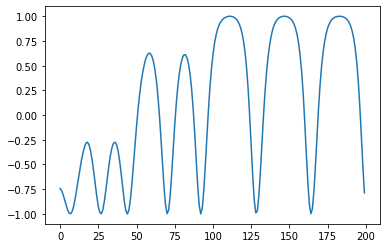

episode: 113/200, score: 37
0.9999877528558336


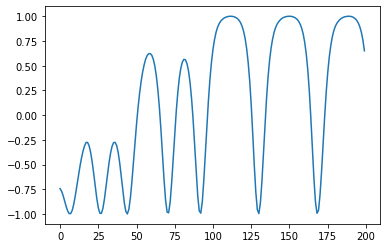

episode: 114/200, score: 37
0.9999083828527812


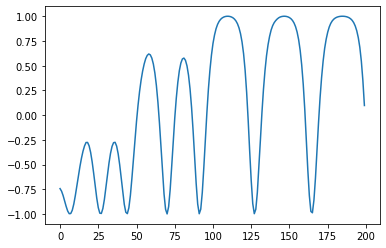

episode: 115/200, score: 39
0.9999952438479471


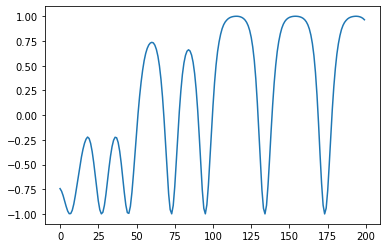

episode: 116/200, score: 36
0.9999903867576349


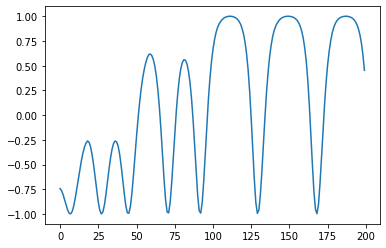

episode: 117/200, score: 41
0.999985316189419


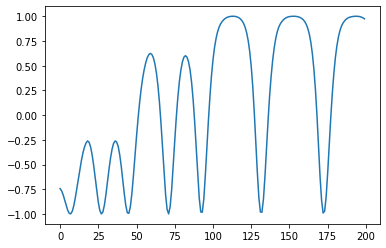

episode: 118/200, score: 39
0.9999941532208623


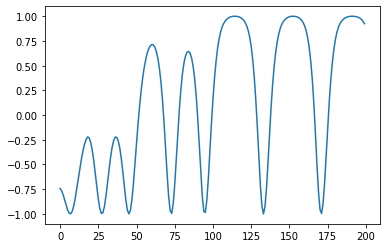

episode: 119/200, score: 40
0.9999598045608157


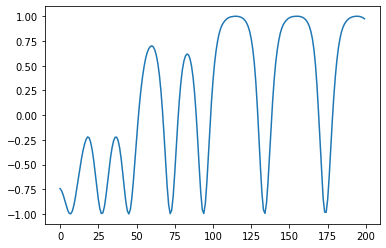

episode: 120/200, score: 41
0.9999981441247564


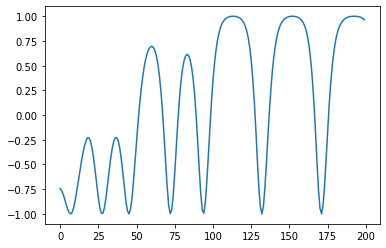

episode: 121/200, score: 41
0.9999823521557506


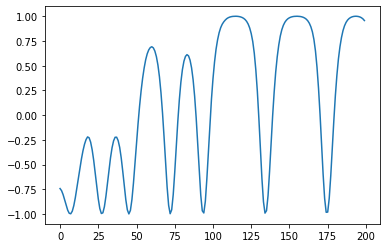

episode: 122/200, score: 39
0.9999694889150849


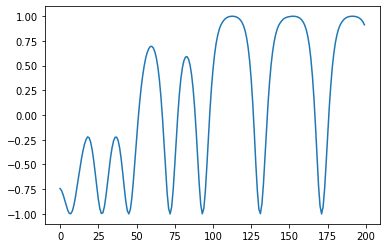

episode: 123/200, score: 39
0.9999983805101776


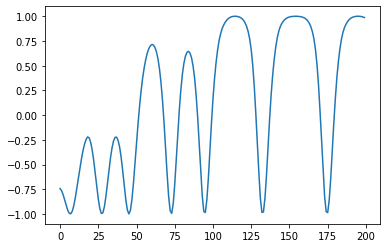

episode: 124/200, score: 38
0.99997779370326


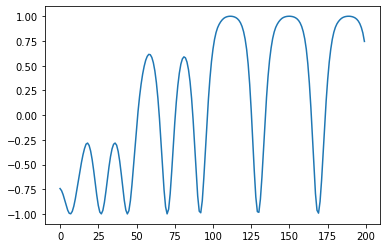

episode: 125/200, score: 40
0.9999995499257518


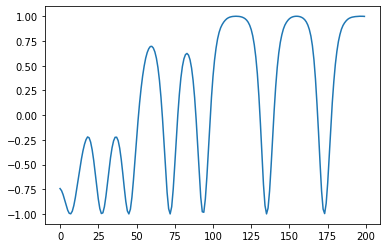

episode: 126/200, score: 41
0.9999999244685642


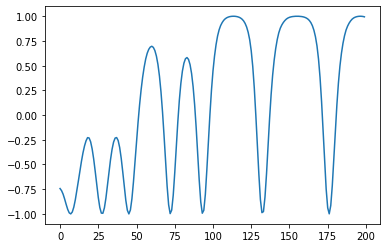

episode: 127/200, score: 40
0.999992585289914


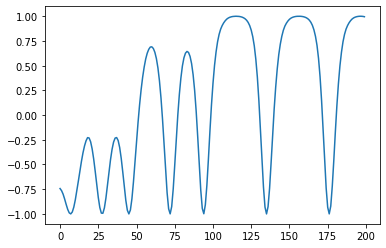

episode: 128/200, score: 40
0.9999985551614393


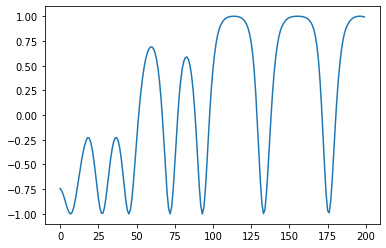

episode: 129/200, score: 40
0.9999999740361983


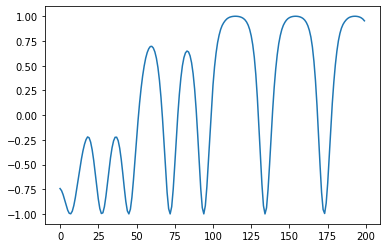

episode: 130/200, score: 42
0.9999954397714396


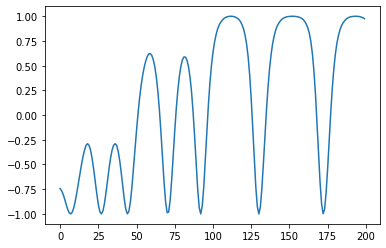

episode: 131/200, score: 44
0.9999999324478266


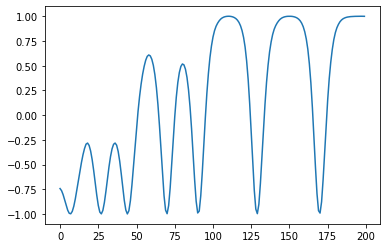

episode: 132/200, score: 42
0.9999971452520768


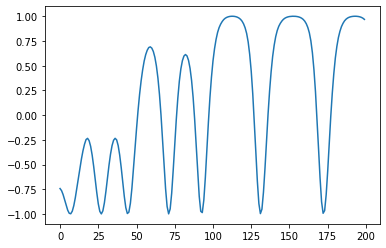

episode: 133/200, score: 60
0.9999983090361275


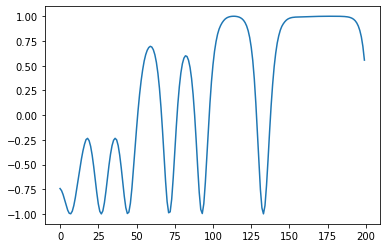

episode: 134/200, score: 38
0.9999397054551697


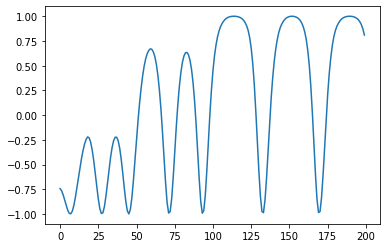

episode: 135/200, score: 41
0.9999829364124306


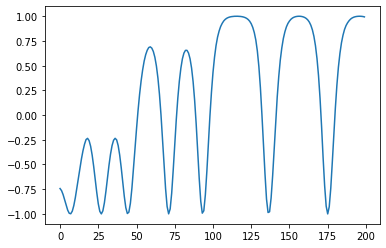

episode: 136/200, score: 42
0.9999953605165917


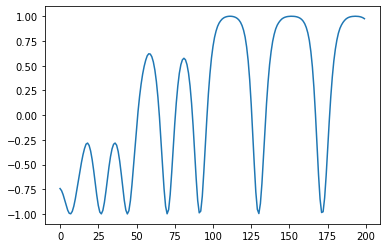

episode: 137/200, score: 38
0.9999797293562382


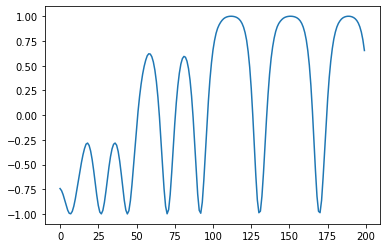

episode: 138/200, score: 41
0.9999947913257464


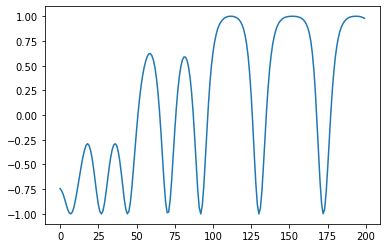

episode: 139/200, score: 41
0.9999948934559637


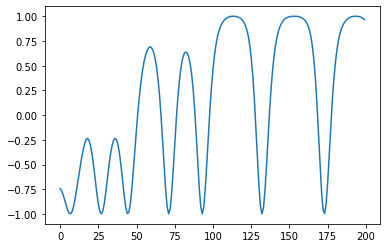

episode: 140/200, score: 37
0.9999545137199065


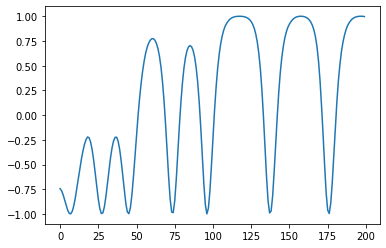

episode: 141/200, score: 41
0.9999994019102405


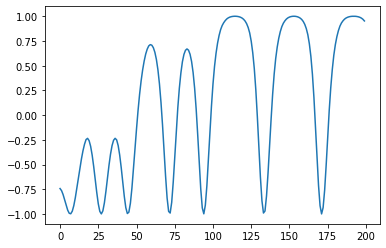

episode: 142/200, score: 40
0.9999978382047364


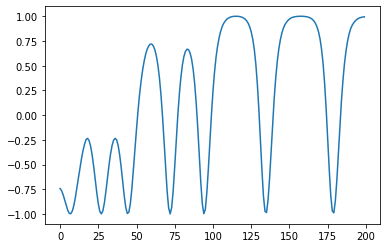

episode: 143/200, score: 41
0.9999991591256554


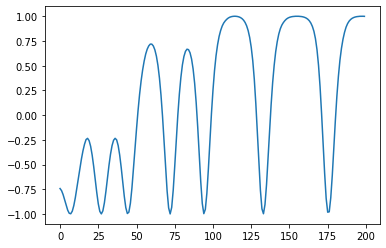

episode: 144/200, score: 41
0.9999756023542831


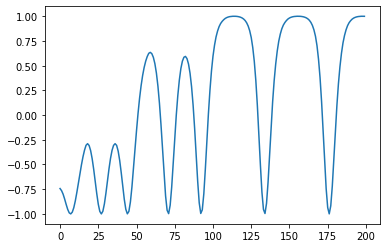

episode: 145/200, score: 39
0.999999257633189


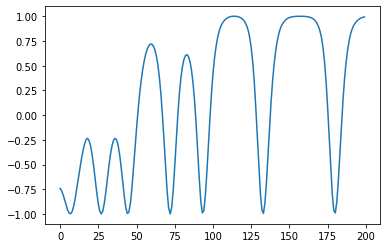

episode: 146/200, score: 62
0.9999941273697752


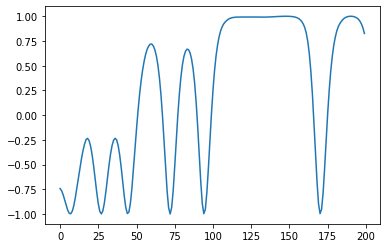

episode: 147/200, score: 39
0.999951976652155


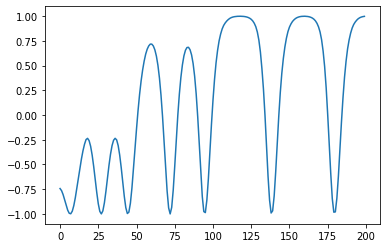

episode: 148/200, score: 40
0.9999872970279934


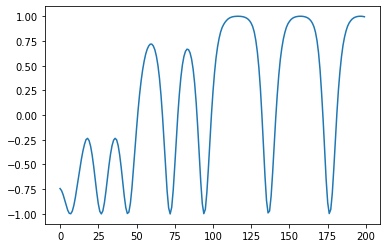

episode: 149/200, score: 41
0.9999929393937378


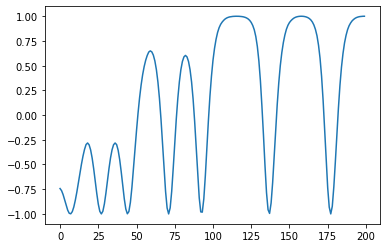

episode: 150/200, score: 40
0.9999878752399896


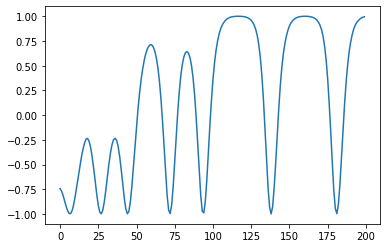

episode: 151/200, score: 40
0.9999998347721731


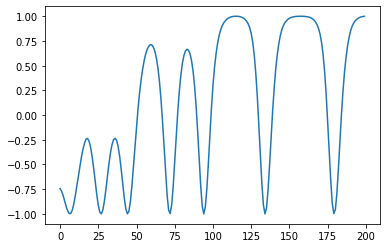

episode: 152/200, score: 39
0.9999285056642511


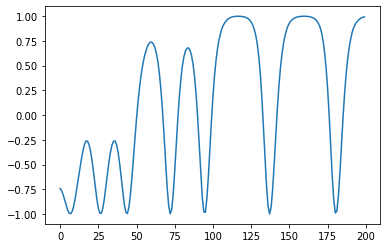

episode: 153/200, score: 39
0.9999772648121951


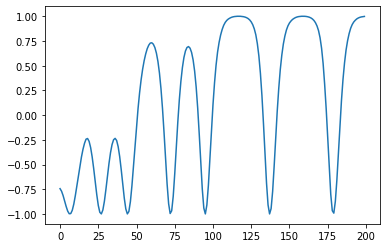

episode: 154/200, score: 39
0.9999999443578195


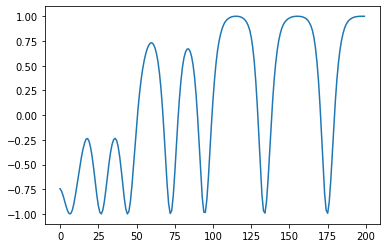

episode: 155/200, score: 36
0.9999978295061306


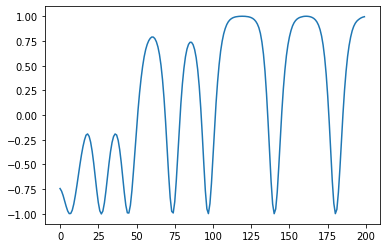

episode: 156/200, score: 39
0.9999885311875988


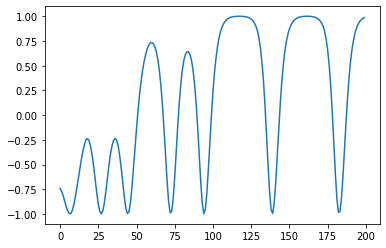

episode: 157/200, score: 38
0.9999994596425512


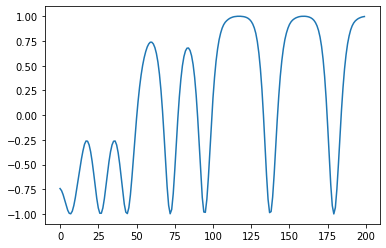

episode: 158/200, score: 38
0.9999974873003649


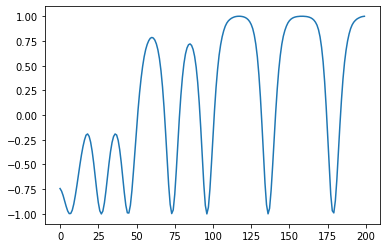

episode: 159/200, score: 38
0.9999866390344353


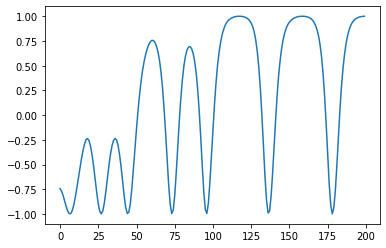

episode: 160/200, score: 38
0.9999964145481591


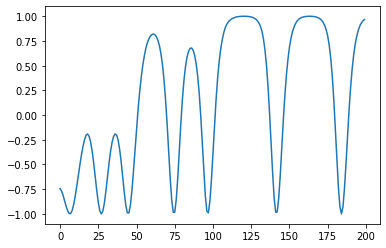

episode: 161/200, score: 38
0.9999879077206044


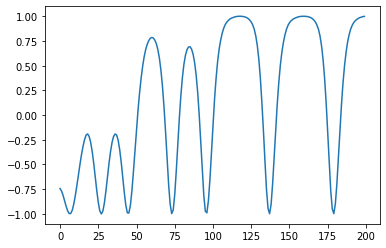

episode: 162/200, score: 38
0.9999790229428936


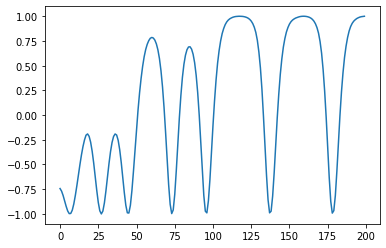

episode: 163/200, score: 37
0.9999965447284435


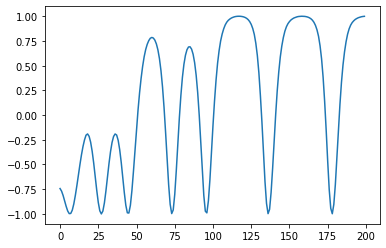

episode: 164/200, score: 38
0.9999974339854178


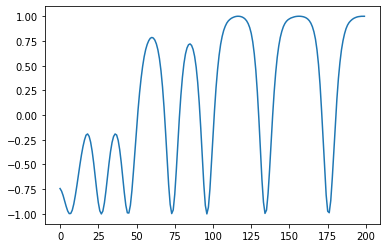

episode: 165/200, score: 38
0.9999926171642987


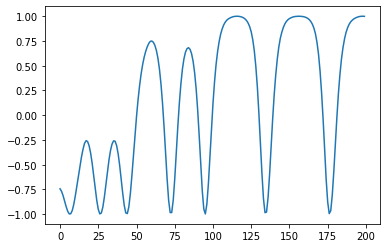

episode: 166/200, score: 37
0.9999974992731059


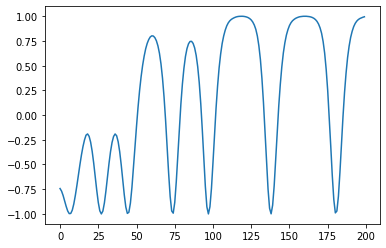

episode: 167/200, score: 36
0.9999795771601979


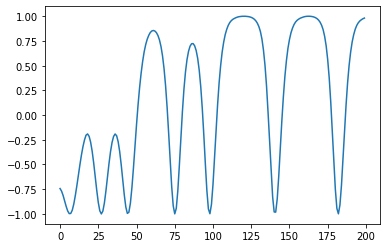

episode: 168/200, score: 37
0.9999925808825135


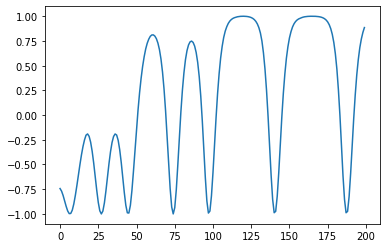

episode: 169/200, score: 35
0.9999912325425463


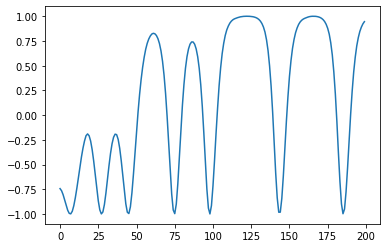

episode: 170/200, score: 36
0.9999989597739647


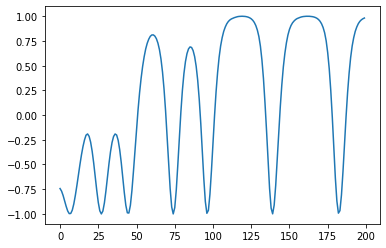

episode: 171/200, score: 35
0.99999987468914


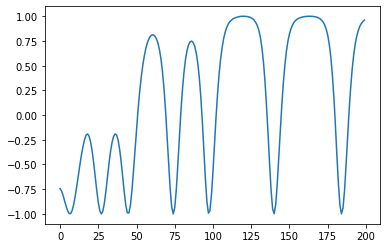

episode: 172/200, score: 37
0.999987721601722


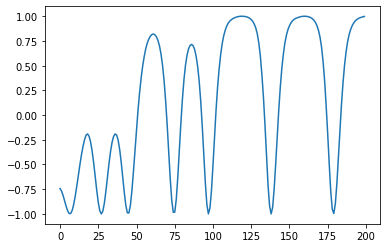

episode: 173/200, score: 36
0.9999996456597896


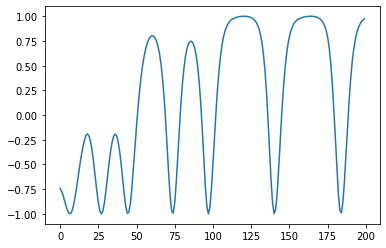

episode: 174/200, score: 36
0.9999965980701008


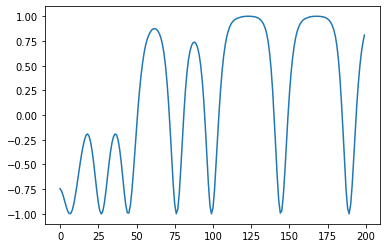

episode: 175/200, score: 36
0.9999999439993877


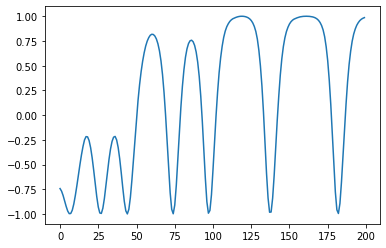

episode: 176/200, score: 35
0.9999980195241246


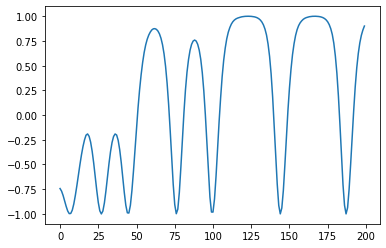

episode: 177/200, score: 33
0.999992534257754


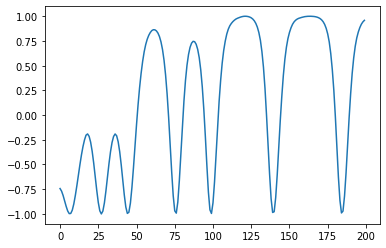

episode: 178/200, score: 50
0.9999998814516429


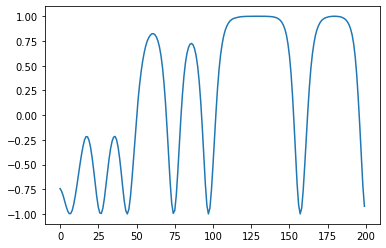

episode: 179/200, score: 35
0.9999997196063891


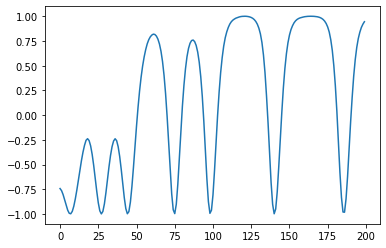

episode: 180/200, score: 48
0.9999993700963107


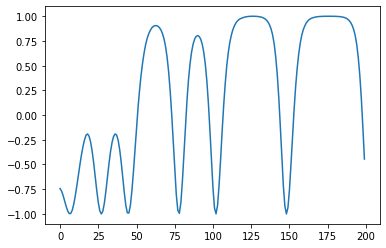

episode: 181/200, score: 60
0.9999999823182678


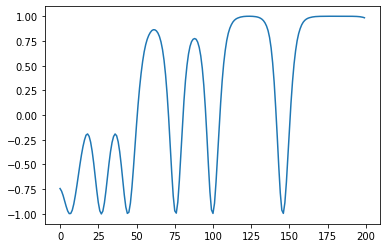

episode: 182/200, score: 37
0.9999982999731424


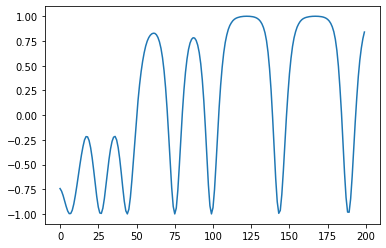

episode: 183/200, score: 41
0.9999773521985159


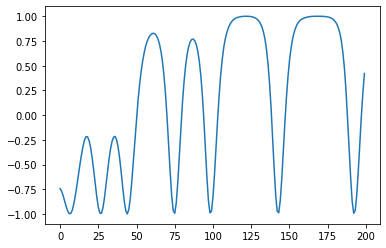

episode: 184/200, score: 37
0.9999708540890091


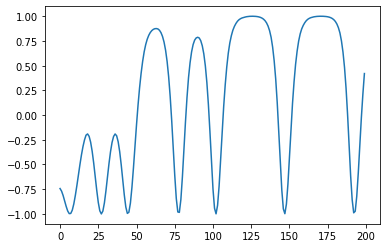

episode: 185/200, score: 36
0.9999892787596542


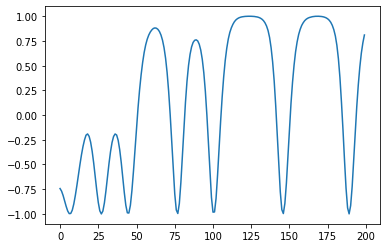

episode: 186/200, score: 33
0.999990189193057


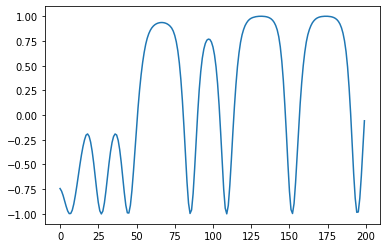

episode: 187/200, score: 44
0.9999987237132032


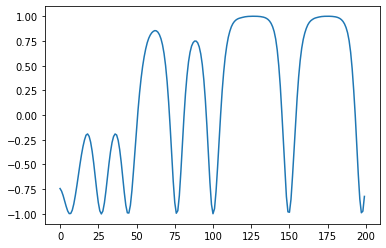

episode: 188/200, score: 54
0.9999429722881167


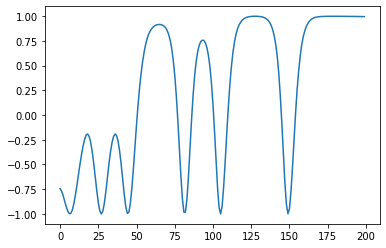

episode: 189/200, score: 31
0.9999723120140328


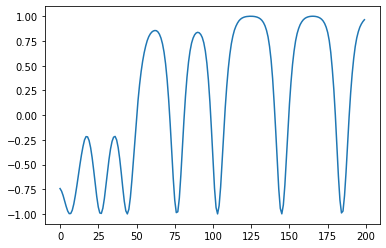

episode: 190/200, score: 60
0.9999743212928001


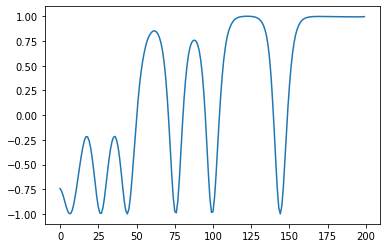

episode: 191/200, score: 84
0.999998915004524


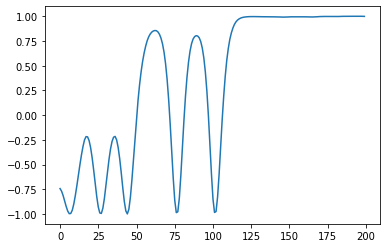

episode: 192/200, score: 51
0.9999999784372107


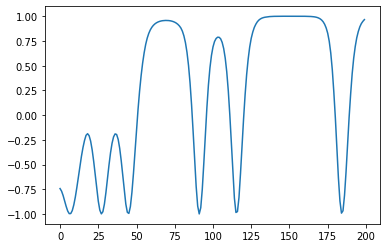

episode: 193/200, score: 38
0.9999988314113798


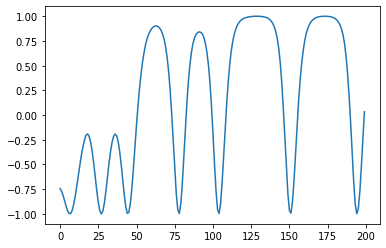

episode: 194/200, score: 52
0.9999956257923851


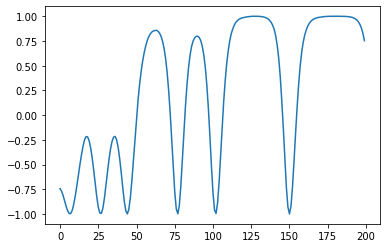

episode: 195/200, score: 52
0.9999980205595349


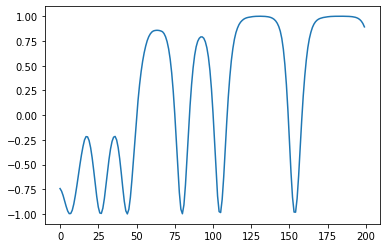

episode: 196/200, score: 44
0.999998466722792


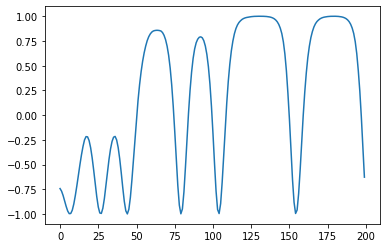

episode: 197/200, score: 44
0.9999979726044885


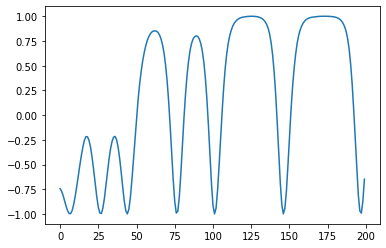

episode: 198/200, score: 41
0.9999765302243669


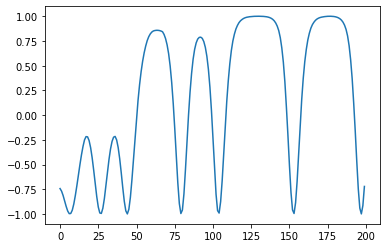

episode: 199/200, score: 44
0.9999961203031402


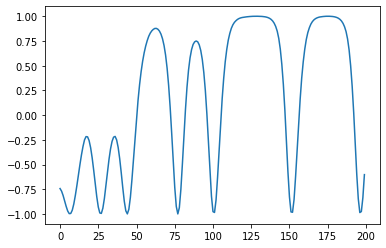

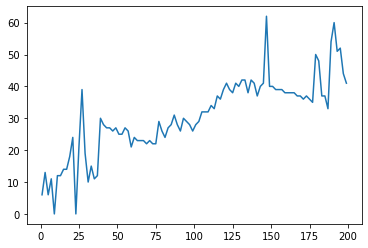

In [12]:
if __name__ == '__main__':
    ep = 200
    loss = train_dqn(ep)
    plt.plot([i+1 for i in range(0, ep, 2)], loss[::2])
    plt.show()

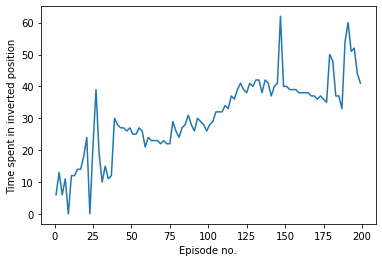

In [13]:
    plt.plot([i+1 for i in range(0, ep, 2)], loss[::2])
    plt.xlabel('Episode no.')
    plt.ylabel('Time spent in inverted position')
    plt.show()